# Derivasjon, kjerneregel og lyd
Dere vet kanskje at lyden vi hører rett og slett er trykkbølger som treffer øret vårt. Men hva betyr egentlig det? Vel det betyr at lufttrykket endrer seg opp og ned, og det er den trykk-endringen som vi hører. Når trykket endrer seg raskt opp og ned hører vi diskante lyder, og når trykket beveger seg sakte opp og ned hører vi bass. Men hvordan kan vi beskrive disse lydene matematisk?

Vel. hvis vi måler trykket ved øret over tid får vi en funksjon, $p(t)$. Mikrofoner kan jo ikke måle funksjonen, men de kan måle hva trykket er ved mange tidspunkt raskt etterhverandre. Ved å bruke numerisk derivasjon kan vi altså derivere lyden vi har målt og spille av denne med høytalerne våre. La oss gjøre det!

Det første vi trenger er å importere `wavfile` fra `scipy.io` for å laste inn en lydfil og `Audio` fra `IPython.display` for å spille av lyden.

In [1]:
from IPython.display import Audio
from scipy.io import wavfile
from requests import request
from pylab import *
import io

La oss nå starte med å laste inn en sang. Sangen vi skal bruke er "Last Summer" av artisten [*Ikson*](https://www.iksonmusic.com/). Dette er en sang som er gratis tilgjengelig, og som vi kan bruke  her så lenge vi krediterer artisten. Du kan finne artisten på [SoundCloud](https://soundcloud.com/ikson/).

Siden dette er en Colab notebook, må vi laste ned sangen fra internett her. Det kan ta en liten stund.

In [2]:
sang_url = "https://github.com/kodeskolen/tekna_v21_videre/raw/main/dag2/notebooks/Numerisk%20derivasjon/lydfiler/Ikson%20-%20Last%20Summer.wav"
fildata = request("get", sang_url).content  # Last ned sangen
buffer = io.BytesIO(fildata)  # Denne variabelen "later" som om den er en fil med sangen vi akkurat lastet ned

In [3]:
målefrekvens, lyd = wavfile.read(buffer)

venstre_kanal = lyd[:, 0]
høyre_kanal = lyd[:, 1]

# Vi tar en liten bit av sangen som starter 10 sekund inn og slutter ett minutt senere
sangbit = venstre_kanal[10*målefrekvens:70*målefrekvens]

C:\Users\Marie\anaconda3\lib\site-packages\ipykernel_launcher.py:1: WavFileWarning: Chunk (non-data) not understood, skipping it.
  """Entry point for launching an IPython kernel.


Her kom det en liten advarsel, den kommer av at filen også inneholder informasjon om artisten og sangen og Python vet ikke helt hvordan det skal tolkes. Derfor ignorerer Python den biten og sier fra til oss i samme slengen.

In [4]:
Audio(sangbit, rate=målefrekvens*1)

**Merk:** For noen nettlesere står det at sangsnutten varer i mange timer, dette er åpenbart feil, og etter at sangen har spilt ferdig vil den ikke prøve å spille mer.

Her kan vi altså høre på sangen vi lastet opp. La oss nå plotte sangen slik at vi kan se på hvordan lufftrykket endrer seg underveis.

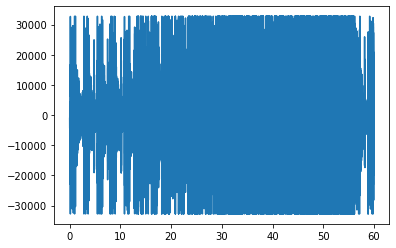

In [5]:
antall_målinger = len(sangbit)
tid = arange(antall_målinger)/målefrekvens

plot(tid, sangbit)
show()

Her var det vanskelig å se noen ting, la oss zoome inn de første 25 sekundene

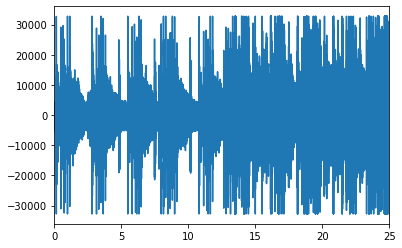

In [6]:
plottelenge_s = 25

plot(tid, sangbit)
xlim(0, 25)
show()

Vi ser altså at lydsignalet nesten er periodisk, og det gir jo mening for vi vet jo at lyden er bygd opp av *bølger*, som vi i matematikken gjerne beskriver med sinus og cosinus funksjoner. Dette skal vi se mer på senere, for nå er vi bare interessert i å derivere lyden.

In [7]:
def deriver(avstandsmålinger, dt):
    antall_målinger = len(avstandsmålinger)
    fart = zeros(antall_målinger-1)
    
    for t in range(antall_målinger-1):
        fart[t] = (avstandsmålinger[t+1] - avstandsmålinger[t])/dt
        
    return fart

def deriver_lyd(lydsignal, målefrekvens):
    lydsignal = lydsignal.astype(float)  # Pass på at vi har lyden som desimaltall
    tid_mellom_målinger = 1/målefrekvens
    
    return deriver(lydsignal, tid_mellom_målinger)

In [8]:
derivert_lyd = deriver_lyd(sangbit, målefrekvens)
Audio(derivert_lyd, rate=målefrekvens)

Hva har skjedd her? All bassen forsvant jo! Vel for å hvorfor bassen forsvinner når vi deriverer lyden må vi tenke oss hva det å derivere lyden faktisk gjør. La oss starte med å lage litt lyd selv som vi analyserer, og se om vi kan forstå hva som skjer når vi deriverer den lyden.

## Lage egen lyd med Python
Vi vet at lyden er i form av lydbølger, og en naturlig måte å lage bølger på matematisk er ved en sinusfunksjon. La oss derfor lage vårt eget lydsignal som følger en sinuskurve!

In [9]:
vår_målefrekvens = 10000
vår_tid = arange(0, 1, 1/vår_målefrekvens)

frekvens_A5 = 880
vår_lyd = sin(frekvens_A5*vår_tid*2*pi)

Her har vi altså lagd en lydbølge som har en frekvens på 1000Hz, men hvordan ser egentlig denne ut? La oss se plotte lydbølgen vår og se på den.

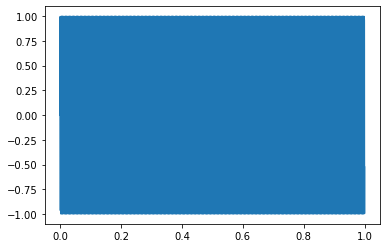

In [10]:
plot(vår_tid, vår_lyd)
show()

Her ser vi ikke mye akkurat. Grunnen til det er at sinusbølga har 2000 topper (1000 over 0 og 1000 under 0) over det sekundet med lyd vi har laget. La oss derfor zoome inn mellom 0 sekund og 0.01 sekund.

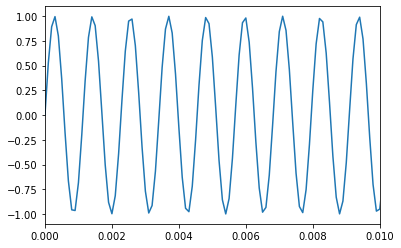

In [11]:
plot(vår_tid, vår_lyd)
xlim(0, 0.01)
show()

Vi ser altså at vi har en veldig raskt oscillerende sinusfunksjon. La oss høre på denne lyden!

In [12]:
Audio(vår_lyd, rate=vår_målefrekvens)

Her hører vi faktisk sinusfunksjonen vår! For de som er kjent med lyd skal dette være en E. Og da kommer jo spørsmålet, hva skjer om vi deriverer denne lyden?

Så kan vi derivere lyden, og høre på hva hvordan lyden er da.

In [13]:
vår_derivert_lyd = deriver_lyd(vår_lyd, vår_målefrekvens)
Audio(vår_derivert_lyd, rate=vår_målefrekvens)

Lyden hørtes jo helt lik ut!? Hvorfor det? La oss plotte denne deriverte lyden og se om vi kan forstå årsaken.

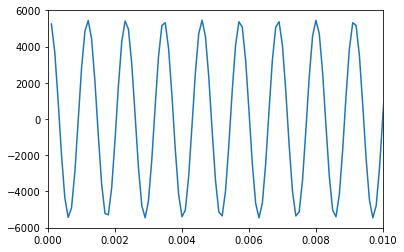

In [14]:
plot(vår_tid[1:], vår_derivert_lyd)
xlim(0, 0.01)
show()

Denne funksjonen er jo veldig lik det originale signalet, for å forstå hvorfor må vi se på hvordan vi kan derivere en sinusfunksjon.

$$ \frac{d}{d t}sin(a t) = - a cos(a t) = a sin\left( a t + \frac{\pi}{4}\right) $$

Vi ser at frekvensen ikke endrer seg, bare fasen og amplituden! For å kunne spille av lyden på høytalerne til PCen blir signalet *normalisert*, det vil si datamaskinen deler signalet på et tall slik at alle verdier er mellom -1 og 1. Når vi deriverer lyden blir altså den eneste endringen fasen til lyden. 

La oss nå endre lyden vår slik at den består av to toner samtidig!

In [15]:
frekvens_A5 = 880
frekvens_B3 = 247
vår_kombinerte_lyd = sin(frekvens_A5*vår_tid*2*pi) + sin(frekvens_B3*vår_tid*2*pi)

Så hører vi på denne lyden

In [16]:
Audio(vår_kombinerte_lyd, rate=vår_målefrekvens)

Her har vi lyden av en A-note og en B-note som spilles med like sterk amplitude, la oss nå prøve å derivere denne lyden.

In [17]:
vår_deriverte_kombinerte_lyd = deriver_lyd(vår_kombinerte_lyd, vår_målefrekvens)
Audio(vår_deriverte_kombinerte_lyd, rate=vår_målefrekvens)

Nå hører vi en lysere tone! Hvorfor det?

Vel vi har et lydsignal på denne formen

$$ sin(a t) + sin(b t), $$

hvis vi deriverer dette signalet, får vi (fra addisjons- og kjederegelen for derivasjon)

$$ a cos(a t) + b cos(b t). $$

I vårt tilfelle er $a = 2 \pi 880$ (en A5 note) og $b = 2 \pi 247$ (en B3 note), etter å ha derivert signalet får vi altså

$$ 2 \pi 880 cos(a t) + 2 \pi 247 cos(b t), $$

den høyfrekvente A-noten blir 3.5 ganger sterkere enn den lavfrekvente B-noten etter at vi har derivert lyden!

Når vi deriverer lyd fjerner vi altså bass-lyder og vi forsterker diskante lyder. 

## Bruk av derivasjon for lydmiksing
Å numerisk derivere lyd er et eksempel på det som heter et *filter* i lyd (og signalbehandling) verdenen. Slike filtre brukes kontinuerlig av lydingeniører. Derivasjonsfilteret vi har innført her er en form for høy-pass filter, og derivasjonsfilteret kan typisk brukes for å etterlikne en dårlig høytaler som sliter med bassen og får til diskantene. Du kan f.eks. prøve å legge til den deriverte lyden på topp av den originale lyden og se hva som skjer!



In [18]:
normalisert_sangbit = sangbit / max(abs(sangbit))
normalisert_derivert_lyd = derivert_lyd / max(abs(derivert_lyd))

kombinert_sang = normalisert_sangbit[1:] + normalisert_derivert_lyd
Audio(kombinert_sang, rate=målefrekvens)

Her høres det faktisk ut som en litt dårlig høytaler. Hvis vi vekter summen, slik at vi har mer eller mindre av originalsangen kan vi endre kvaliteten på høytaleren. La oss spille av musikken på en litt dårligere høytaler.

In [19]:
kombinert_sang = normalisert_sangbit[1:] + 10*normalisert_derivert_lyd
Audio(kombinert_sang, rate=målefrekvens)

Vi kan høre på originalsangen igjen for å sammenlikne

In [20]:
Audio(sangbit, rate=målefrekvens)